Let us assume we are given the wavefunction at initial time $W(x,t=0)$. How do we calculate $W(x,t)$ for arbitrary t?

There are two steps:
1. Calculate the natural frequencies of system (= eigen-energies) using the Schrodinger equation. 
2. Use linearity: each eigenmode contained in the wavefunction evolves in time as $e^{-i E t/\hbar}$, with its own eigen-energy $E$. So we can just add up the time-evolved version of each mode contained in the wavefunction.

## Finding the eigen-energies

_This is just a repeat of what you have done before_

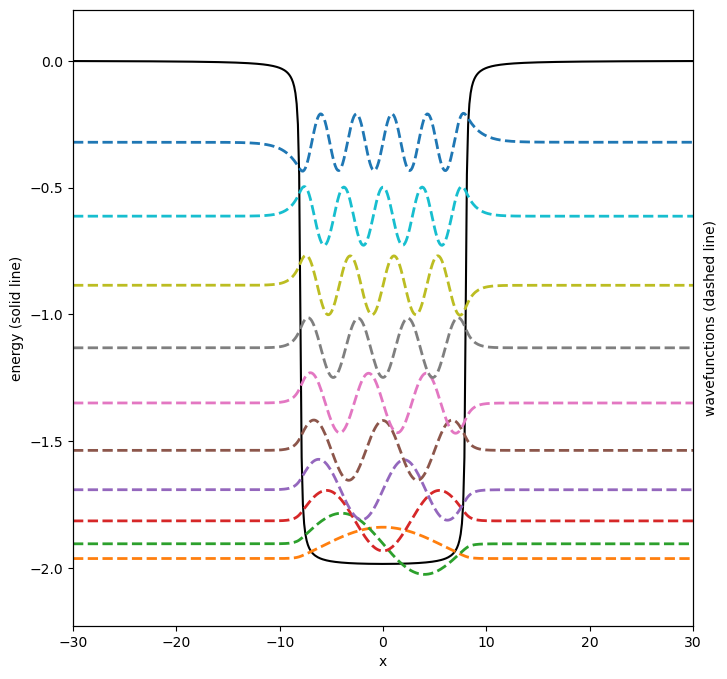

In [1]:
import numpy as np
from numpy import arctan,pi
from scipy import linalg as lg
import matplotlib.pyplot as plt

from matplotlib import animation
from IPython.display import HTML

%matplotlib inline

def V(x):
    return (arctan((x-8)/0.1)/(pi/2) - arctan((x+8)/0.1)/(pi/2))   # a squarish well
    # return 0.5*x**2                                              # a harmonic oscillator with k=1

N = 500       # number of discrete points on the spatial grid
x = np.linspace(-30,30,N)
dx = x[1]-x[0]


# ----- the solver -----
V_matrix = np.matrix(np.diag(V(x)))                                                  # matrix version of V(x)
K_matrix = -0.5*np.matrix( np.eye(N,k=-1) - 2*np.eye(N) + np.eye(N,k=+1) )/dx**2     # matrix version of -1/2 d^2/dx^2
eigen_energies,eigvecs = lg.eigh(K_matrix + V_matrix)
# ...... that's it! ....... 

eigenmodes = eigvecs.T

fig,ax = plt.subplots(figsize=(8,8))
ax.plot(x,V(x),color='k')
ax.set_xlabel("x")
ax.set_ylabel("energy (solid line)",color='k')

for i in range(10):
    ax.plot(x,eigenmodes[i] + eigen_energies[i],'--',lw=2,color=f"C{i+1}")  

ax2 = ax.twinx()
ax2.set_ylabel("wavefunctions (dashed line)")
ax2.set_yticks([])
ax.margins(0,0.1)
plt.show()

### Finding the wavefunction at an arbitrary time

In [2]:
# ---------------------------------
def evolve(wavepacket,t):
    # this needs us to have already solved for the eigenmodes and eigen-energies    
    output = 0
    for i in range(N):
        output += np.dot(eigenmodes[i],wavepacket) *eigenmodes[i]*np.exp(-1j*eigen_energies[i]*t) 
    return output

# ......... that's it ! ...........

def E_avg(wavepacket):
    # this just calculates <E> for a given wavefunction
    wavepacket = np.matrix(wavepacket)
    return np.trace( wavepacket*(K_matrix+V_matrix)*wavepacket.H) / np.trace(wavepacket *wavepacket.H)


Let us try this out with a "gaussian" wavepacket as our initial wavefunction: $W(x,0) = \mathcal{N} \, e^{-(x-2)^2/\Omega^2}$.

This is centered at $x=2$, and has a "width" equal to $\Omega$. The constant $\mathcal{N}$ just ensures that $\int |W(x)|^2 \, dx = 1$ so that the wavefunction $W$ gives rise to a legitimate probability density. 

_(Turns out we don't even need to calculate $\mathcal{N}$ explicitly -- Python can normalize things for us!)_

In [3]:
W0 = np.exp(-(x-2)**2/1.5**2)                     # initial wavefunction
W0 = W0/np.sqrt( np.trapz(np.abs(W0)**2,x) )    # normalize W0 so that it is a proper probability density

# check if wavefunction remains normalized during the time evolution
print(f"Initial integral of pdf = {np.trapz(np.abs(W0)**2,x):.6f}")
print(f"@ t=10000, integral of pdf = {np.trapz(np.abs(evolve(W0,10000))**2,x):.6f}")


# check if <E> remains conserved during the time evolution
print(f"Initial value of <E> = {E_avg(W0):.6f}")
print(f"@ t=10000, value of <E> = {E_avg(evolve(W0,10000)):.6f}")

Initial integral of pdf = 1.000000
@ t=10000, integral of pdf = 1.000000
Initial value of <E> = -1.760948
@ t=10000, value of <E> = -1.760948-0.000000j


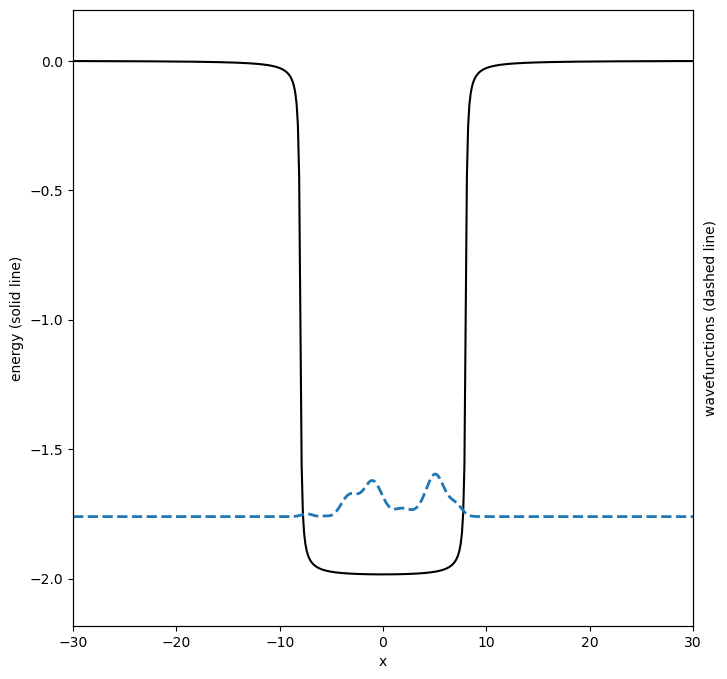

In [4]:
fig,ax = plt.subplots(figsize=(8,8))
ax.plot(x,V(x),color='k')
ax.set_xlabel("x")
ax.set_ylabel("energy (solid line)",color='k')

ax2 = ax.twinx()
ax2.set_ylabel("wavefunctions (dashed line)")
ax2.set_yticks([])

line, = ax.plot(x,np.abs(W0)**2 + E_avg(W0),'--',lw=2)
ax.margins(0,0.1)

def animate(i):
    line.set_data(x,np.abs(evolve(W0,i))**2 + E_avg(W0))

ani = animation.FuncAnimation(fig, animate, frames=200)
HTML(ani.to_jshtml())

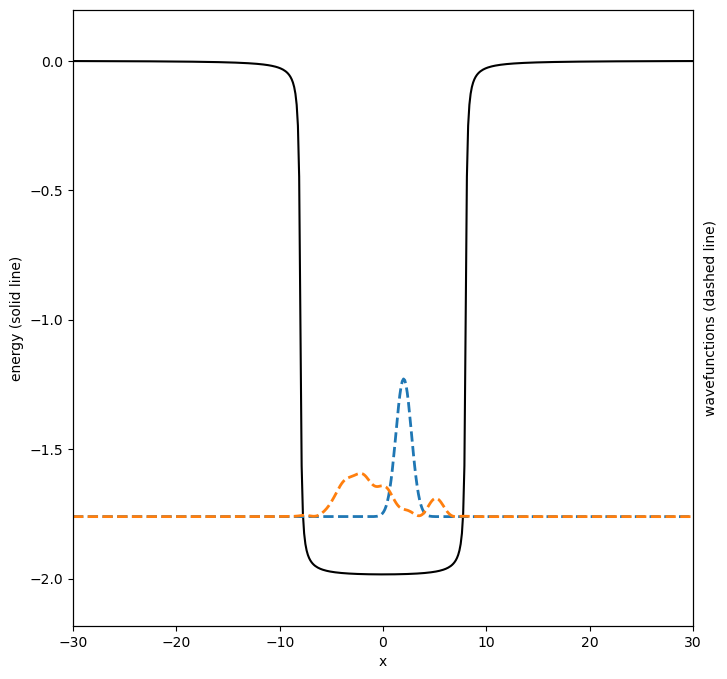

In [5]:
fig,ax = plt.subplots(figsize=(8,8))
ax.plot(x,V(x),color='k')
ax.set_xlabel("x")
ax.set_ylabel("energy (solid line)",color='k')

ax2 = ax.twinx()
ax2.set_ylabel("wavefunctions (dashed line)")
ax2.set_yticks([])

ax.plot(x,np.abs(W0)**2 + E_avg(W0),'--',lw=2)
ax.plot(x,np.abs(evolve(W0,2000))**2 + E_avg(W0),'--',lw=2)

ax.margins(0,0.1)

## Harmonic oscillator

Let's use these same ideas to solve the harmonic oscillator problem.

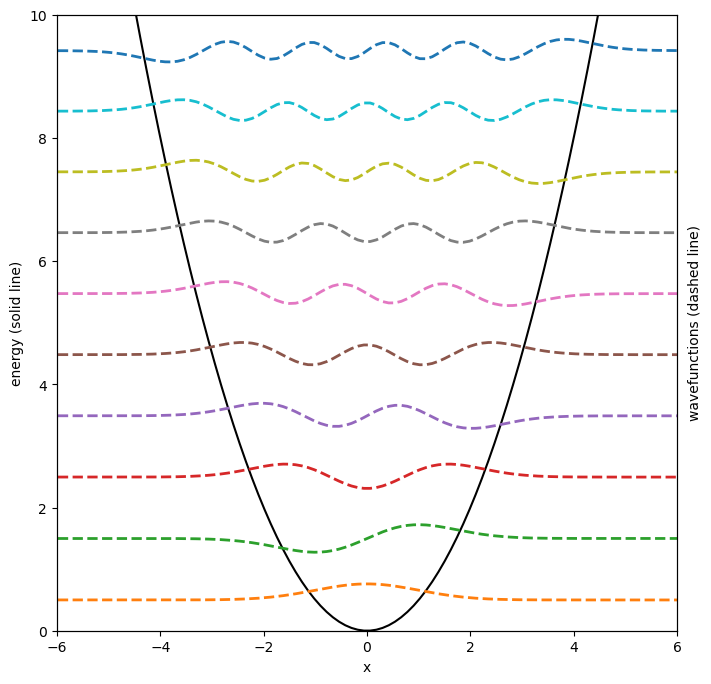

In [6]:
def V(x):
    return 0.5*x**2                                              # a harmonic oscillator with k=1

N = 500       # number of discrete points on the spatial grid
x = np.linspace(-30,30,N)
dx = x[1]-x[0]

# ----- the solver -----
V_matrix = np.matrix(np.diag(V(x)))                                                  # matrix version of V(x)
K_matrix = -0.5*np.matrix( np.eye(N,k=-1) - 2*np.eye(N) + np.eye(N,k=+1) )/dx**2     # matrix version of -1/2 d^2/dx^2
eigen_energies,eigvecs = lg.eigh(K_matrix + V_matrix)
# ...... that's it! ....... 

eigenmodes = eigvecs.T

fig,ax = plt.subplots(figsize=(8,8))
ax.plot(x,V(x),color='k')
ax.set_xlabel("x")
ax.set_ylabel("energy (solid line)",color='k')

for i in range(10):
    ax.plot(x,eigenmodes[i] + eigen_energies[i],'--',lw=2,color=f"C{i+1}")  

ax2 = ax.twinx()
ax2.set_ylabel("wavefunctions (dashed line)")
ax2.set_yticks([])
ax.set_ylim(0,10)
ax.set_xlim(-6,6)
ax.margins(0,0.1)
plt.show()

Since we have already defined `evolve()` and `E_avg()`, we don't need to repeat the definitions.

In [7]:
W0 = np.exp(-(x+3)**2/1.4**2)                     # initial wavefunction
W0 = W0/np.sqrt( np.trapz(np.abs(W0)**2,x) )    # normalize W0 so that it is a proper probability density

# check if wavefunction remains normalized during the time evolution
print(f"Initial integral of pdf = {np.trapz(np.abs(W0)**2,x):.6f}")
print(f"@ t=10000, integral of pdf = {np.trapz(np.abs(evolve(W0,10000))**2,x):.6f}")


# check if <E> remains conserved during the time evolution
print(f"Initial value of <E> = {E_avg(W0):.6f}")
print(f"@ t=10000, value of <E> = {E_avg(evolve(W0,10000)):.6f}")

Initial integral of pdf = 1.000000
@ t=10000, integral of pdf = 1.000000
Initial value of <E> = 4.999632
@ t=10000, value of <E> = 4.999632+0.000000j


/usr/lib/python3.10/site-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


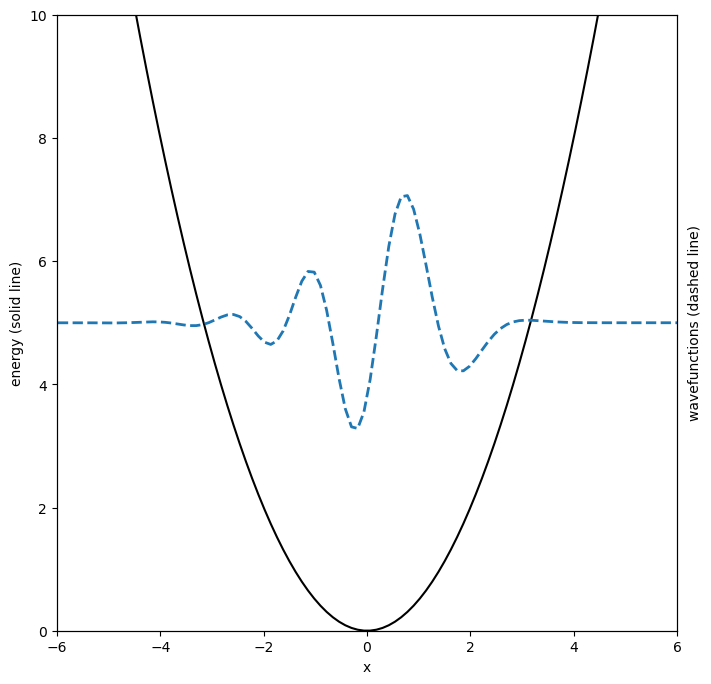

In [8]:
fig,ax = plt.subplots(figsize=(8,8))
ax.plot(x,V(x),color='k')
ax.set_xlabel("x")
ax.set_ylabel("energy (solid line)",color='k')

ax2 = ax.twinx()
ax2.set_ylabel("wavefunctions (dashed line)")
ax2.set_yticks([])

line, = ax.plot(x,3*W0 + E_avg(W0),'--',lw=2)
ax.set_xlim(-6,6)
ax.set_ylim(0,10)
ax.margins(0,0.1)

def animate(i):
    line.set_data(x,3*(evolve(W0,i/5)) + E_avg(W0))

ani = animation.FuncAnimation(fig, animate, frames=200)
HTML(ani.to_jshtml())